In [15]:
import pathlib
import numpy as np
import scipy as sp
import pandas as pd
from matplotlib import pyplot as plt
import astropy as ast
from astropy import stats



import SessionTools.two_photon as st2p

plt.rcParams['pdf.fonttype']=42

%load_ext autoreload
%autoreload 2 


%matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [18]:
basedir = pathlib.Path('/media/mplitt/SSD_storage/2P_scratch/EL_hm4Di_R60D05LexA_jRGECO1a')
sess_df = pd.read_csv(basedir / 'sessions.csv')
sess_df = sess_df.iloc[:-1]
print(sess_df.columns)
sess_df['fly_id'] = [row['date']+'_'+row['fly'] + '_' +row['condition']  for _, row in sess_df.iterrows()]
sess_df['mean offset'] = [np.nan for _, row in sess_df.iterrows()]
sess_df['offset var.'] = [np.nan for _, row in sess_df.iterrows()]
sess_df['mean vec. len'] = [np.nan for _, row in sess_df.iterrows()]


figfolder = pathlib.Path('/media/mplitt/SSD_storage/fig_scratch/EL_hm4Di_R60D05LexA_LexOpjRGECO1a')
figfolder.mkdir(parents=True, exist_ok=True)


sess_df = sess_df.loc[(sess_df['usable']==1) * (sess_df['dcz_concentration (nM)']<100)]

Index(['date', 'fly', 'sess', 'fictrac_scan_num', 'fictrac_file', 'condition',
       'dcz_concentration (nM)', 'closed_loop', 'usable', 'notes'],
      dtype='object')


In [19]:
sess_df.head()

,date,fly,sess,fictrac_scan_num,fictrac_file,condition,dcz_concentration (nM),closed_loop,usable,notes,fly_id,mean offset,offset var.,mean vec. len
3,23_09_2024,fly2,closed_loop-000,0,fictrac-20240923_091227.dat,dcz_control,0,1,1,NaN,23_09_2024_fly2_dcz_control,NaN,NaN,NaN
4,23_09_2024,fly2,dark-001,1,fictrac-20240923_091227.dat,dcz_control,0,0,1,NaN,23_09_2024_fly2_dcz_control,NaN,NaN,NaN
5,23_09_2024,fly2,closed_loop-002,2,fictrac-20240923_091227.dat,dcz_control,0,2,1,NaN,23_09_2024_fly2_dcz_control,NaN,NaN,NaN
21,24_09_2024,fly1,closed_loop-000,0,fictrac-20240924_080209.dat,dcz_control,0,1,1,collagenase,24_09_2024_fly1_dcz_control,NaN,NaN,NaN
22,24_09_2024,fly1,dark-001,1,fictrac-20240924_080209.dat,dcz_control,0,0,1,NaN,24_09_2024_fly1_dcz_control,NaN,NaN,NaN


In [20]:
for index,row in sess_df.iterrows():
   
    outdir = pathlib.PurePath( basedir  / row['condition'] / row['date'] / row['fly'] / row['sess'] / 'preprocess.pkl')
    pp = st2p.preprocessing.EBImagingSession.from_file(outdir)
    dff = pp.calculate_zscored_F('rois', exp_detrend=True, zscore=True, background_ts='background')[-1,:,:] 
    y_sm = sp.ndimage.gaussian_filter1d(sp.ndimage.gaussian_filter1d(dff, 2., axis=-1),.7,axis=1, mode='wrap')
    

    heading = np.angle(np.exp(1j*(-1*pp.voltage_recording_aligned[' Heading'].to_numpy()-np.pi)))
    h_mask = np.abs(heading)<2.5


    x_f,y_f = st2p.utilities.pol2cart(y_sm ,np.linspace(-np.pi,np.pi,num=dff.shape[0])[:,np.newaxis])
    rho,phi = st2p.utilities.cart2pol(x_f.mean(axis=0), y_f.mean(axis=0))

    _,offset = st2p.utilities.cart2pol(*st2p.utilities.pol2cart(np.ones(heading.shape),phi-heading))
    # print(offset.shape)


    x_o, y_o = st2p.utilities.pol2cart(np.ones(heading[h_mask].shape), offset[h_mask])
    r, offset_mu = st2p.utilities.cart2pol(x_o.mean(), y_o.mean())

    sess_df.loc[index, 'mean offset'] = offset_mu
    sess_df.loc[index, 'mean vec. len'] = r
    sess_df.loc[index, 'offset var.'] = sp.stats.circvar(offset[h_mask])

    

In [21]:
fly_ids = sess_df['fly_id'].unique()

cond_ids = np.zeros((len(fly_ids),))
for i, fly in enumerate(fly_ids):
    cond_state = sess_df['condition'].loc[sess_df['fly_id']==fly].iloc[0]
    if 'dcz_control' in cond_state:
        cond_ids[i]=0
    elif 'dcz' in cond_state:
        cond_ids[i]=1
    elif 'hm4di_control' in cond_state:
        cond_ids[i]=2
    else: 
        cond_ids[i]=-1


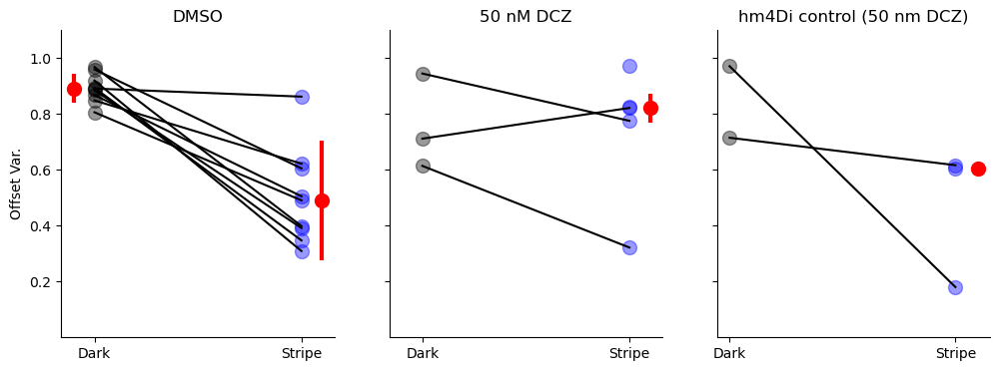

In [22]:
fly_avgs = np.zeros((len(fly_ids),2))
for r, fly in enumerate(fly_ids):
    
    mask = (sess_df['fly_id']==fly)*(sess_df['closed_loop']>=2)
    
    cl = sess_df['offset var.'].loc[mask].mean()
    fly_avgs[r,0]=cl
    
    mask = (sess_df['fly_id']==fly)*(sess_df['closed_loop']==0)
    dark = sess_df['offset var.'].loc[mask].mean()
    fly_avgs[r,1] = dark
    

fig,ax = plt.subplots(1,3,sharey=True, figsize=[12,4])

c_h = ax[0].plot([0,1],fly_avgs[cond_ids==0,::-1].T, color='black')
ax[0].scatter(np.zeros(((cond_ids==0).sum(),)),fly_avgs[cond_ids==0,-1], color='black', alpha=.4,s=100)
ax[0].scatter(np.ones(((cond_ids==0).sum(),)),fly_avgs[cond_ids==0,0], color='blue', alpha=.4,s=100)
# ax[0].plot([0,1], [fly_avgs[cond_ids==0,-1].mean(), fly_avgs[cond_ids==0,0].mean()],linewidth=5)
ax[0].scatter([-.1,1.1], [np.median(fly_avgs[cond_ids==0,-1]), np.median(fly_avgs[cond_ids==0,0])],s=100, color='red')
ax[0].errorbar([-.1,1.1], [np.median(fly_avgs[cond_ids==0,-1]), np.median(fly_avgs[cond_ids==0,0])], yerr=sp.stats.iqr(fly_avgs[cond_ids==0,:],axis=0)[::-1], 
               color='red', linewidth=0,elinewidth=3)
ax[0].set_title('DMSO')

c_h = ax[1].plot([0,1],fly_avgs[cond_ids==1,::-1].T, color='black')
ax[1].scatter(np.zeros(((cond_ids==1).sum(),)),fly_avgs[cond_ids==1,-1], color='black', alpha=.4,s=100)
ax[1].scatter(np.ones(((cond_ids==1).sum(),)),fly_avgs[cond_ids==1,0], color='blue', alpha=.4,s=100)

ax[1].scatter([-.1,1.1], [np.median(fly_avgs[cond_ids==1,-1]), np.median(fly_avgs[cond_ids==1,0])],s=100, color='red')
ax[1].errorbar([-.1,1.1], [np.median(fly_avgs[cond_ids==1,-1]), np.median(fly_avgs[cond_ids==1,0])], yerr=sp.stats.iqr(fly_avgs[cond_ids==1,:],axis=0)[::-1], 
               color='red', linewidth=0,elinewidth=3)
ax[1].set_title('50 nM DCZ')


_h = ax[2].plot([0,1],fly_avgs[cond_ids==2,::-1].T, color='black')
ax[2].scatter(np.zeros(((cond_ids==2).sum(),)),fly_avgs[cond_ids==2,-1], color='black', alpha=.4,s=100)
ax[2].scatter(np.ones(((cond_ids==2).sum(),)),fly_avgs[cond_ids==2,0], color='blue', alpha=.4,s=100)

ax[2].scatter([-.1,1.1], [np.median(fly_avgs[cond_ids==2,-1]), np.median(fly_avgs[cond_ids==2,0])],s=100, color='red')
# ax[2].errorbar([-.1,1.1], [np.median(fly_avgs[cond_ids==2,-1]), np.median(fly_avgs[cond_ids==2,0])], yerr=sp.stats.iqr(fly_avgs[cond_ids==2,:],axis=0)[::-1], 
#                color='red', linewidth=0,elinewidth=3)
ax[2].set_title('hm4Di control (50 nm DCZ)')


for i in range(3):
    ax[i].set_ylim([0.0,1.1])
    ax[i].set_yticks([.2,.4,.6,.8,1.])

    ax[i].set_xticks([0, 1], labels=['Dark', 'Stripe'])
    ax[i].spines['top'].set_visible(False)
    ax[i].spines['right'].set_visible(False)
ax[0].set_ylabel('Offset Var.')
# ax[0].grid(True)
# ax[1].grid(True)
fig.savefig(figfolder / 'summary_offsets.pdf')

In [8]:
print(fly_avgs[cond_ids==0,:].shape, fly_avgs[cond_ids==1,:].shape)

(9, 2) (5, 2)


In [9]:
t, p = sp.stats.mannwhitneyu(np.diff(fly_avgs[cond_ids==0,:], axis=-1), np.diff(fly_avgs[cond_ids==1,:],axis=-1),nan_policy='omit')
print(t,p)

[24.] [0.06363636]


In [10]:
t, p = sp.stats.mannwhitneyu(fly_avgs[cond_ids==0,0], fly_avgs[cond_ids==1,0], nan_policy='omit')
print(t,p)

11.0 0.14685314685314685


In [11]:
t, p = sp.stats.wilcoxon(fly_avgs[cond_ids==0,0] - fly_avgs[cond_ids==0,1], nan_policy='omit')
print(t,p)

0.0 0.00390625


In [12]:
t, p = sp.stats.wilcoxon(fly_avgs[cond_ids==1,0]- fly_avgs[cond_ids==1,1], nan_policy='omit')
print(t,p)

1.0 0.5


In [40]:
(fly_avgs[cond_ids==1,0] - fly_avgs[cond_ids==1,1]).mean()

-0.16855791745732718

In [41]:
np.nanmean(fly_avgs[cond_ids==0,0] - fly_avgs[cond_ids==0,1])

-0.38989504111965506

In [42]:
np.nanmean(fly_avgs[cond_ids==1,0]) - np.nanmean(fly_avgs[cond_ids==0,0])

0.20152050513639863

In [15]:
def get_ts(pp, coef = 0):
    y_epg = pp.timeseries['rois_z']
    heading = np.angle(np.exp(1j*(-1*pp.voltage_recording_aligned[' Heading'].to_numpy()-np.pi)))
    bar_vis_mask = np.abs(heading)<2.5
   
    y_epg_sm = sp.ndimage.gaussian_filter1d(sp.ndimage.gaussian_filter1d(y_epg-1, 2, axis=-1),.7,axis=1, mode='wrap')
    
    
    n_rois = y_epg.shape[1]
    x_f,y_f = st2p.utilities.pol2cart(y_epg[-1,:,:] ,np.linspace(-np.pi,np.pi,num=n_rois)[:,np.newaxis])
    rho_epg, phi_epg = st2p.utilities.cart2pol(x_f.mean(axis=0), y_f.mean(axis=0))


    _,offset_epg = st2p.utilities.cart2pol(*st2p.utilities.pol2cart(np.ones(heading.shape),phi_epg-heading))

    
    return {'heading': heading,
            'bar_vis_mask': bar_vis_mask,
            'y_epg': y_epg,
            'y_epg_sm': y_epg_sm,
            'rho_epg': rho_epg,
            'phi_epg': phi_epg,
            'offset_epg': offset_epg}


def align_to_heading(ts):
    heading_bins = np.linspace(-np.pi, np.pi, num=17)
    heading_dig = np.digitize(ts['heading'], heading_bins)-1

    y_h_aligned = np.zeros([1,*ts['y_epg'].shape[1:]])
    for ind in range(ts['heading'].shape[0]):
        y_h_aligned[-1,:,ind] = np.roll(ts['y_epg'][-1,:,ind], -heading_dig[ind]-8)
        # y_h_aligned[1,:,ind] = np.roll(ts['y_epg'][1,:,ind], -heading_dig[ind])
       
        
    y_h_aligned_z = np.zeros((1,16,16))
    for b in range(16):
        mask = heading_dig==b
        y_h_aligned_z[:,:,b] = y_h_aligned[:,:,mask].mean(axis=-1)
    
    
    return heading_bins, y_h_aligned, y_h_aligned_z

In [16]:
eg_folder = figfolder / 'example_sessions' 
eg_folder.mkdir(parents=True, exist_ok=True)

/tmp/ipykernel_3330380/1195902111.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax=plt.subplots(1,2, figsize=[30,3])


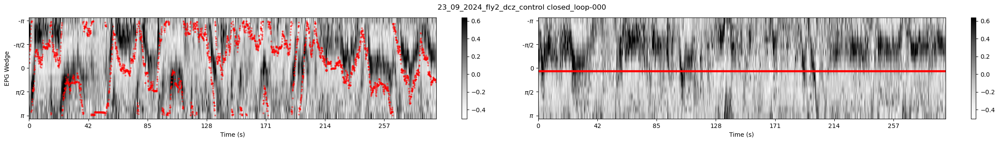

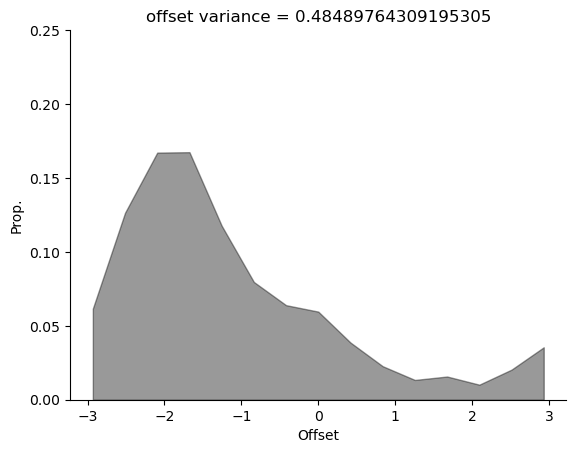

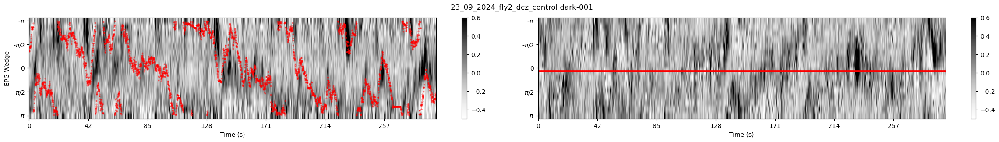

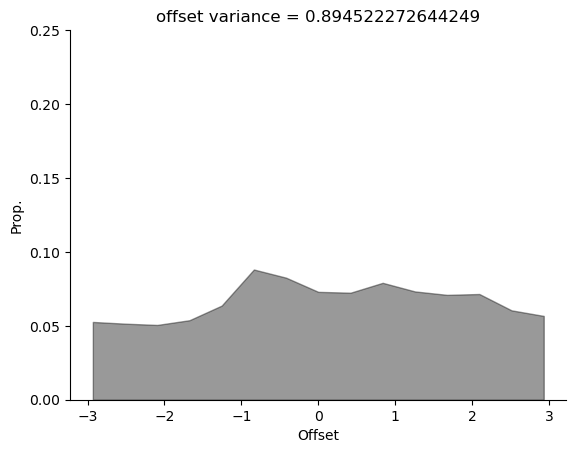

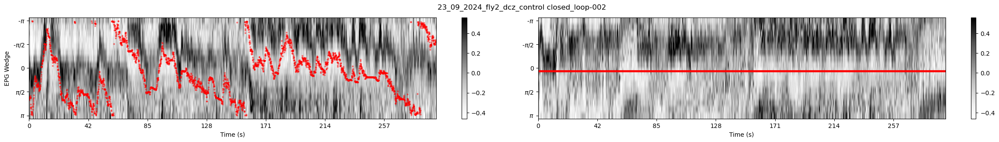

...

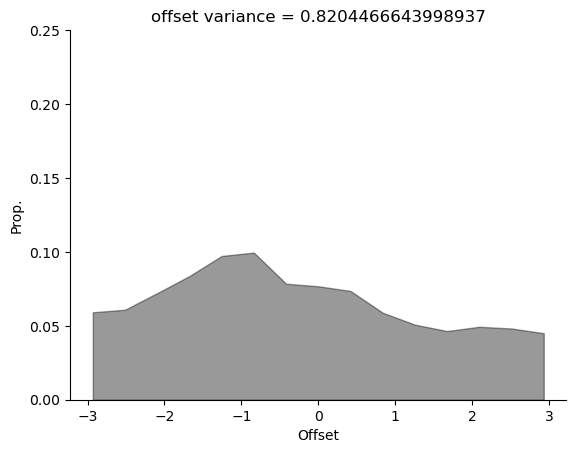

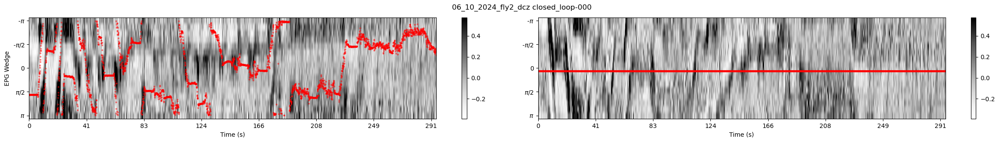

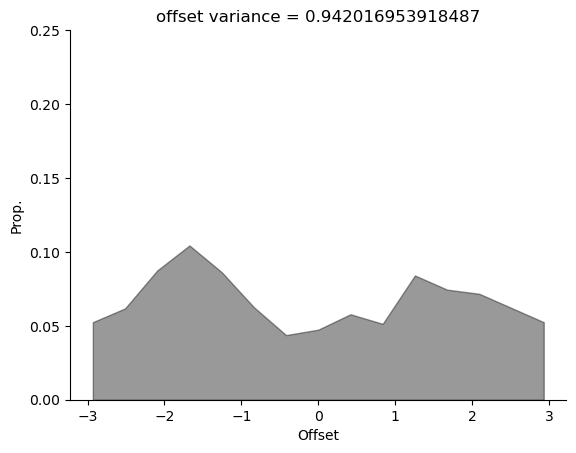

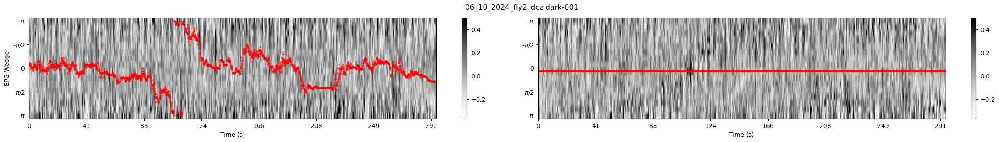

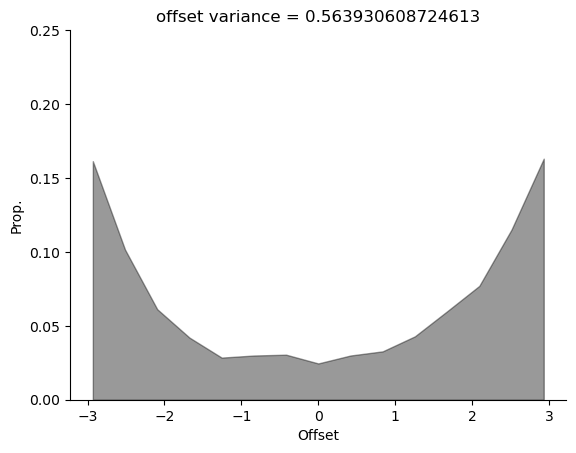

In [17]:
for i, (_, row) in enumerate(sess_df.iterrows()):
    outdir = pathlib.PurePath( basedir  / row['condition'] / row['date'] / row['fly'] / row['sess'] / 'preprocess.pkl')
    pp = st2p.preprocessing.EBImagingSession.from_file(outdir)
    ts = get_ts(pp,coef=0)
    bins = np.arange(16)
    
    window = slice(0,10000)
    
    starting_offset = ts['offset_epg'][window][:50]
    so_x, so_y = st2p.utilities.pol2cart(np.ones_like(starting_offset), starting_offset)
    _, starting_offset_mu = st2p.utilities.cart2pol(so_x.mean(axis=0), so_y.mean(axis=0))
    _heading_centered = np.copy(ts['heading'][window]) + starting_offset_mu
    _, heading_centered = st2p.utilities.cart2pol(*st2p.utilities.pol2cart(np.ones_like(_heading_centered), _heading_centered))
    

    
    # print(pp.voltage_recording_aligned['Time(ms)'])
    dt = pp.metadata['frame_period']*pp.metadata['layout']['frames_per_sequence']
    
    fig, ax=plt.subplots(1,2, figsize=[30,3])
    plt.subplots_adjust(wspace=0)
    h = ax[0].imshow(ts['y_epg'][-1,:,window]-1,aspect='auto',cmap='Greys', 
                 vmin=np.percentile(ts['y_epg'][-1,:,:]-1,5), 
                 vmax=np.percentile(ts['y_epg'][-1,:,:]-1,95))
    plt.colorbar(h)
    _heading = 15*(ts['heading'][window]+np.pi)/2/np.pi
    # _heading = 15*(heading_centered+np.pi)/2/np.pi
    
    x = np.arange(_heading.shape[0])
    
    t = np.arange(0,x[-1]*dt,dt)
    
    ax[0].scatter(x,_heading, color='red', s=4, alpha=.4)
    
    heading_bins, y_h_aligned, y_h_aligned_z = align_to_heading(ts)
    h = ax[1].imshow(y_h_aligned[-1,:,window]-1, aspect='auto',cmap='Greys', 
                 vmin=np.percentile(ts['y_epg'][-1,:,:]-1,5), 
                 vmax=np.percentile(ts['y_epg'][-1,:,:]-1,95))
    
    plt.colorbar(h)
    ax[1].scatter(x,8*np.ones_like(x), color='red', s=4, alpha=.4)
    
    ax[0].set_xticks(x[::500],labels=[int(_t) for _t in t[::500]])
    ax[1].set_xticks(x[::500],labels=[int(_t) for _t in t[::500]])
    for a in range(2):
        ax[a].set_yticks([r/2/np.pi*15 for r in (0,  np.pi/2,  np.pi,  6*np.pi/4,  2*np.pi)], 
                                                 labels = [r'-$\pi$',  r'-$\pi$/2',  '0',  r'$\pi$/2',  r'$\pi$'])
    ax[0].set_ylabel('EPG Wedge')
    ax[0].set_xlabel('Time (s)')
    ax[1].set_xlabel('Time (s)')
    
    # ax[1].hist(ts['offset_epg'],bins = np.linspace(-np.pi,np.pi, num=17), density=True)
    fig.suptitle(f"{row['fly_id']} {row['sess']}")
    fig.savefig(eg_folder / f"{row['fly_id']}_{row['sess']}_heading_centered.pdf")
#     add shifted data and histogram


    fig, ax = plt.subplots()
    edges = np.linspace(-np.pi,np.pi,num=16)
    centers = (edges[:-1]+edges[1:])/2
    hist, _ = np.histogram(ts['offset_epg'], bins = np.linspace(-np.pi,np.pi,num=16))
    ax.fill_between(centers, hist/hist.sum(), alpha=.4, color='black')
    ax.set_ylim([0,.25])
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.set_xlabel('Offset')
    ax.set_ylabel('Prop.')
    offset_var = sp.stats.circvar(ts['offset_epg'])
    ax.set_title(f"offset variance = {offset_var}")
    fig.savefig(eg_folder / f"{row['fly_id']}_{row['sess']}_offset_histogram.pdf")